In [1]:
import os
import sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.font_manager
import seaborn as sns
import anndata
import scanpy as sc
import re
import decoupler as dc
import scvi
import warnings
import decoupler as dc

warnings.filterwarnings("ignore")
warnings.simplefilter("ignore")


/well/immune-rep/users/vbw431/conda/ivybridge/envs/scverse_new/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/well/immune-rep/users/vbw431/conda/ivybridge/envs/scverse_new/lib/python3.8/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: /gpfs3/well/immune-rep/users/vbw431/conda/ivybridge/envs/scverse_new/lib/python3.8/site-packages/torchvision/image.so: undefined symbol: _ZN5torch3jit17parseSchemaOrNameERKSs
  warn(f"Failed to load image Python extension: {e}")
Global seed set to 0
/well/immune-rep/users/vbw431/conda/ivybridge/envs/scverse_new/lib/python3.8/site-packages/flax/struct.py:132: FutureWarning: jax.tree_util.register_keypaths is deprecated, and will be removed in a future release. Please use `register_pytree_with_keys()` instead.
  jax.tree_util.reg

In [2]:
data_dir = "/well/immune-rep/users/vbw431/Projects/Peppa/data/"
newdata_dir = "/well/immune-rep/users/vbw431/Projects/Peppa/new_analysis/data/"
plot_dir = "/well/immune-rep/users/vbw431/Projects/Peppa/new_out/final_plots/"




In [3]:
##load data
adata = sc.read_h5ad("/well/immune-rep/users/vbw431/Projects/Peppa/out/peppa_azi_combat.h5ad")

labels = ["NK", "CD8", "CD4", "Bcells", "Myeloid_Plt"]
cluster_list = {}
scvi_list = {}
umap_list = {}
for i in [0,1,2,3,4]:
    print("reading in " + labels[i])
    cluster_list[labels[i]] = pd.read_csv(os.path.join(newdata_dir + labels[i] +"_clustering_final/", f"Peppa_{labels[i]}_cluster_assignment.csv"), index_col =0)
    scvi_list[labels[i]] = pd.read_csv(os.path.join(newdata_dir + labels[i] +"_embeddings/", f"Peppa_{labels[i]}_scvi.csv"), index_col =0)
    umap_list[labels[i]] = pd.read_csv(os.path.join(newdata_dir + labels[i] +"_embeddings/", f"Peppa_{labels[i]}_umap.csv"), index_col =0)

##generate adata_list
adata_list = {}

for i in [0,1,2,3, 4]:
    adata_list[labels[i]] = adata[cluster_list[labels[i]].index].copy()
    adata_list[labels[i]].obsm["X_scVI"] = scvi_list[labels[i]].loc[adata_list[labels[i]].obs_names].values
    adata_list[labels[i]].obsm["X_umap"] = umap_list[labels[i]].loc[adata_list[labels[i]].obs_names].values
    adata_list[labels[i]].obs = adata_list[labels[i]].obs.merge(cluster_list[labels[i]], left_index=True, right_index=True, how="inner")
    adata_list[labels[i]].layers['counts'] = adata_list[labels[i]].X.copy()
    sc.pp.normalize_total(adata_list[labels[i]], target_sum=1e4)
    sc.pp.log1p(adata_list[labels[i]])
    adata_list[labels[i]].layers['normalized'] = adata_list[labels[i]].X.copy()
    
##update meta_data with new clinical
clin_meta = pd.read_csv(newdata_dir + "index_demo.csv", index_col = 0)
clin_meta = clin_meta[["disease_group", 
                       "bio_replicate", 
                       "study_disease", 
                       "scanpy_index", 
                       "study_ID", 
                       "Treatment_status",
                      "Ethnicity",
                      "Sex",
                      "Age",
                      "HBV_serostatus",
                      "HBV_sAg_titre",
                      "HBV_DNA_VL"]]

new_obs = {}

for name in labels:
    del adata_list[name].obs["disease_group"]
    adata_list[name].obs["study_disease_orig"] = adata_list[name].obs["study_disease"].copy()
    del adata_list[name].obs["study_disease"]
    new_df = pd.merge(adata_list[name].obs, clin_meta, how='left', left_on = ['bio_replicate','scanpy_index'], right_on = ['bio_replicate','scanpy_index'])
    new_df.index = adata_list[name].obs.index
    new_obs[name] = new_df.copy()
    adata_list[name].obs = new_df.copy()

                 
for name in labels:
    adata_list[name].obs["celltype_consensus"] = str(name)

for name in labels:
    adata_list[name].obs["celltype_consensus.l1"] = str(name)
    adata_list[name].obs["celltype_consensus.l2"] = adata_list[name].obs[str(name+".annotation.l1")]
    adata_list[name].obs["celltype_consensus.l3"] = adata_list[name].obs[str(name+".annotation.l2")]
    
##concat
adata_all = anndata.concat(adata_list, join= "outer", index_unique=None)



reading in NK
reading in CD8
reading in CD4
reading in Bcells
reading in Myeloid_Plt


## Select treated groups and timepoint 0 from azimuth

In [4]:
##Assign CMV status based on azimuth preprint (https://doi.org/10.1016/j.cell.2021.04.048)

conditions = [
  ([re.search("_0|SeuratProject",a) is not None for a in adata_all.obs["orig.ident"]]),
  ([re.search("_0|SeuratProject",a) is None for a in adata_all.obs["orig.ident"]]),
 ]

# create a list of the values we want to assign for each condition
values = ["Subset", "Remove"]

# create a new column and use np.select to assign values to it using our lists as arguments
adata_all.obs["prevax"] = np.select(conditions, values)
adata_all = adata_all[adata_all.obs["prevax"] == "Subset"].copy()


In [5]:
NK = adata_all[adata_all.obs["celltype_consensus.l1"] == "NK"].copy()

In [6]:
np.max(NK.layers["counts"])
NK.X = NK.layers["counts"].copy()
sc.pp.normalize_total(NK, target_sum=1e4)
sc.pp.log1p(NK)

## Add other NK modules of interest

In [7]:
##Cytotoxicity
# Retrieve MSigDB resource
msigdb = dc.get_resource('MSigDB')
msigdb

# Filter by a desired geneset collection, for example hallmarks
msigdb = msigdb.drop_duplicates(['geneset', 'genesymbol'])

Cytolytic_score = ["GZMB", "GZMA", "GZMK", "GZMM", "GZMH", "TNF", "FASLG", "TNFSF10", "PRF1"]


In [8]:
exhausted = msigdb[(msigdb['geneset'].str.contains("EXHAUSTED_VS"))].copy()
exhausted = exhausted[(exhausted['geneset'].str.contains("UP"))].genesymbol.tolist()

In [9]:
##Exhaustion and TOX pathways 
Scott = pd.read_csv(newdata_dir+"SCOTT_TOX_induced_genes.csv")
Bengsch = pd.read_csv(newdata_dir+"bengsch_exhaustion.csv")

In [10]:
Scott["gene"] = Scott["gene"].str.upper()

In [11]:
##filter for up regulated genes in exhaustion
Bengsch = Bengsch[Bengsch["Direction"].isin(["UP"])].copy()
Scott = Scott[Scott["log2FoldChange"] >0.25].copy()
Scott = Scott.gene.unique().tolist()

##Generic T cell exhaustion markers
T_exhaus = ["PDCD1", "CTLA4", "LAYN", "LAG3", "HAVCR2", "CD244","CD160"]

In [12]:
import rpy2.rinterface_lib.callbacks
import anndata2ri
import logging
import rpy2.robjects.lib.ggplot2 as gp
from rpy2.robjects import pandas2ri
from rpy2.robjects import r
from rpy2.ipython.ggplot import image_png

#sc.settings.verbosity = 0
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

In [13]:
%%R
.libPaths(c(paste0("/well/immune-rep/users/vbw431/conda/ivybridge/envs/scverse_new/r_modules"), .libPaths()))

library(tidyverse)
library(Seurat)
library(SCPA)
library(UCell)
cur.dir = "/well/immune-rep/users/vbw431/Projects/Peppa/data/DIMITRA_FASTQ/"
work.dir = "/well/immune-rep/users/vbw431/Projects/Peppa/"
out.dir = "/well/immune-rep/users/vbw431/Projects/Peppa/new_analysis/out/"
references = "/well/immune-rep/users/vbw431/reference/reference/refdata-gex-GRCh38-2020-A/"
com.out = "/well/immune-rep/users/vbw431/Projects/Peppa/reference_combat/"

##plotting
library(ggplot2); theme_set(theme_bw(base_size = 18)+
                              theme(strip.text = element_text(colour = 'black', face="bold",size=12), 
                                    panel.grid.major = element_blank(), 
                                    panel.grid.minor = element_blank(),
                                    panel.border = element_rect(size = 0.7),
                                    axis.ticks.length=unit(.10, "cm"),
                                    axis.ticks = element_line(size=0.7),
                                    strip.background = element_blank()))



-- Attaching core tidyverse packages ------------------------ tidyverse 2.0.0 --
v dplyr     1.1.2     v readr     2.1.4
v forcats   1.0.0     v stringr   1.5.0
v lubridate 1.9.2     v tibble    3.2.1
v purrr     1.0.1     v tidyr     1.3.0
-- Conflicts ------------------------------------------ tidyverse_conflicts() --
x purrr::%@%()                 masks rlang::%@%()
x lazyeval::as_name()          masks rlang::as_name()
x lazyeval::call_modify()      masks rlang::call_modify()
x lazyeval::call_standardise() masks rlang::call_standardise()
x lazyeval::expr_label()       masks rlang::expr_label()
x lazyeval::expr_text()        masks rlang::expr_text()
x lazyeval::f_env()            masks rlang::f_env()
x lazyeval::f_env<-()          masks rlang::f_env<-()
x lazyeval::f_label()          masks rlang::f_label()
x lazyeval::f_lhs()            masks rlang::f_lhs()
x lazyeval::f_lhs<-()          masks rlang::f_lhs<-()
x lazyeval::f_rhs()            masks rlang::f_rhs()
x lazyeval::f_rhs<-() 

In [14]:
%%R -i Bengsch -i Scott -i Cytolytic_score -i T_exhaus
##import exhaustion scores

NULL


In [15]:
%%R 
#load data 

##load, normalise  and trim to remove pre_treatment replicates and post vaccine samples from azimuth

peppa <- readRDS(paste0(out.dir, "/peppa_pbmc_all.rds"))

##filter pre vaccination samples and pre treatment samples out
peppa <- subset(peppa, subset = Treatment_status != "Pre_treatment")

trim_barcodes <- peppa@meta.data %>% 
  dplyr::select(orig.ident) %>%
  dplyr::filter(grepl("_0|SeuratProject", orig.ident))
table(trim_barcodes)

peppa <- subset(peppa, cells = rownames(trim_barcodes))



In [16]:
%%R
score_list <- list("Bengsch_exhaustion_score" = Bengsch$Hu.ESG, 
                "Scott_exhaustion_score" = Scott,
                "NK_cytotoxicity_score" = Cytolytic_score,
                "T_cell_exhaustion_score" = T_exhaus)


In [17]:
%%R

peppa <- AddModuleScore_UCell(peppa, features = score_list)


In [18]:
%%R
NK <- subset(peppa, subset = celltype_consensus.l1 == "NK")


In [19]:
%%R
##downsample evenly per cell subset per condition
set.seed(1)
adaptive_barcodes <- NK@meta.data %>%
mutate(cells = rownames(.)) %>%
filter(grepl("NK.Adaptive$", celltype_consensus.l2))%>%
group_by(celltype_consensus.l2, study_disease) %>%
sample_n(2000,replace=FALSE) %>% 
ungroup() %>% 
select(cells) %>% 
unlist()

set.seed(1)
adaptive_chemo_barcodes <- NK@meta.data %>%
mutate(cells = rownames(.)) %>%
filter(grepl("NK.Adaptive.CCL4.CCL3$", celltype_consensus.l2))%>%
group_by(celltype_consensus.l2, study_disease) %>%
sample_n(400,replace=FALSE) %>% 
ungroup() %>% 
select(cells) %>% 
unlist()

set.seed(1)
adaptive_mat_barcodes <- NK@meta.data %>%
mutate(cells = rownames(.)) %>%
filter(grepl("NK.Mature$", celltype_consensus.l2))%>%
group_by(celltype_consensus.l2, study_disease) %>%
sample_n(500,replace=FALSE) %>% 
ungroup() %>% 
select(cells) %>% 
unlist()



downsample_cells <- c(adaptive_barcodes, adaptive_chemo_barcodes, adaptive_mat_barcodes)

NK <- subset(NK, cells = downsample_cells)


In [20]:
NK_scvi = scvi_list["NK"]

In [21]:
NK_scvi.shape

(29503, 20)

In [22]:
%%R -i NK_scvi

NK_scvi <- NK_scvi[rownames(NK_scvi) %in% colnames(NK),]
NK_scvi <- as.matrix(NK_scvi)
colnames(NK_scvi) <- as.integer(colnames(NK_scvi))+1
colnames(NK_scvi)

NK[["scvi"]]<- CreateDimReducObject(embeddings = NK_scvi, global = T,key = "scvi_", assay = "RNA")


In [23]:
%%R
NK <- SmoothKNN(NK, signature.names = paste0(names(score_list),"_UCell"), reduction="scvi")


In [24]:
%%R
NK_meta <- NK@meta.data


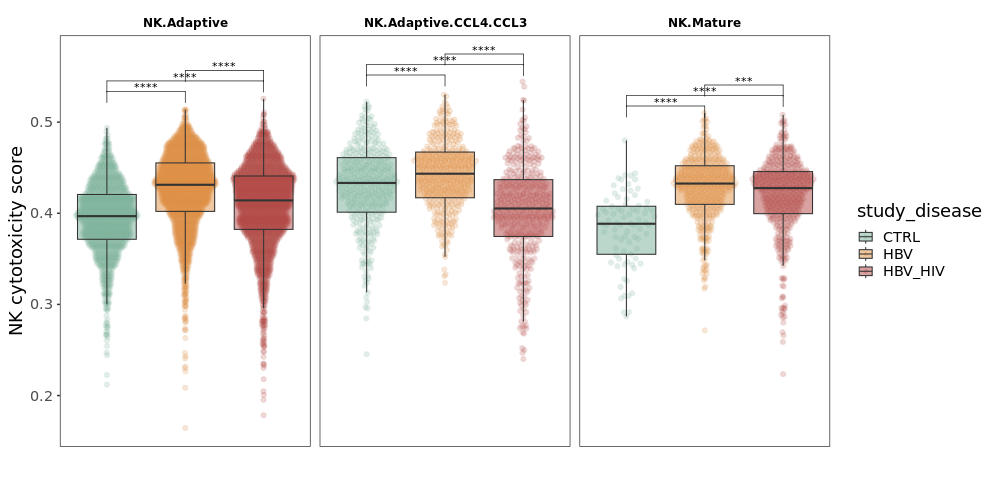

In [25]:
%%R -w 1000
library(rstatix)
library(ggbeeswarm)
##Cytotoxicity 
study_cols <-  c("CTRL"="#79AF97FF","HBV"="#DF8F44FF", "HBV_HIV" = "#B24745FF" )

NK_cyto_dunn <- NK_meta %>%
filter(!grepl("Pre", Treatment_status)) %>%
filter(!grepl("Azimuth", Ref_lab)) %>%
group_by(celltype_consensus.l2) %>% 
ungroup() %>%
select(celltype_consensus.l2,study_disease, 
       NK_cytotoxicity_score_UCell_kNN) %>%
reshape2::melt(id.vars=c("celltype_consensus.l2", "study_disease")) %>% 
group_by(celltype_consensus.l2, study_disease, variable) %>%
ungroup() %>%
group_by(celltype_consensus.l2) %>% 
dunn_test(value~study_disease) %>%
add_xy_position()

NK_cyto_plot<-NK_meta %>%
filter(!grepl("Pre", Treatment_status)) %>%
filter(!grepl("Azimuth", Ref_lab)) %>%
select(celltype_consensus.l2,study_disease, 
       NK_cytotoxicity_score_UCell_kNN) %>%
reshape2::melt(id.vars=c("celltype_consensus.l2", "study_disease")) %>% 
group_by(celltype_consensus.l2, study_disease, variable) %>%
ggplot(aes(study_disease, value))+
ggrastr::rasterise(geom_quasirandom(aes(color=study_disease),alpha=0.2))+
geom_boxplot(aes(fill = study_disease),outlier.alpha=0, alpha=0.5)+
facet_wrap(~celltype_consensus.l2, ncol=4)+
xlab("")+
ylab("NK cytotoxicity score")+
theme(axis.text.x = element_blank(), axis.ticks.x = element_blank())+
scale_fill_manual(values = study_cols)+ 
scale_color_manual(values = study_cols)+ 
ggpubr::stat_pvalue_manual(NK_cyto_dunn %>% filter(p.adj.signif!= "ns"))

print(NK_cyto_plot)


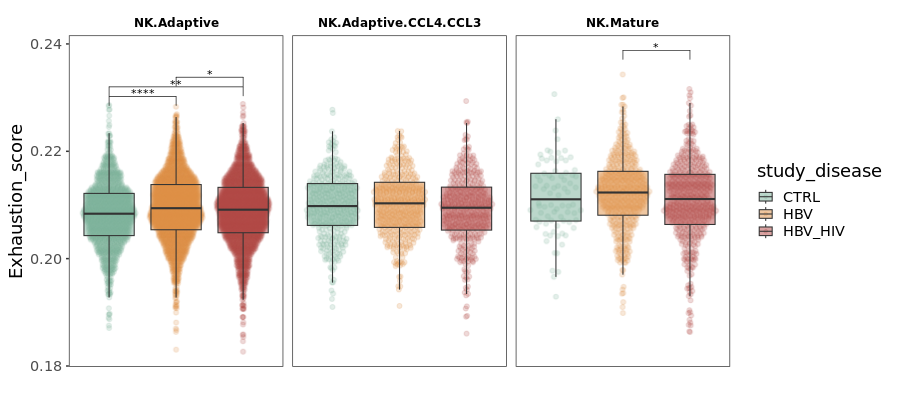

In [26]:
%%R -w 900 -h 400

NK_exh_dunn <- NK_meta %>%
filter(!grepl("Pre", Treatment_status)) %>%
filter(!grepl("Azimuth", Ref_lab)) %>%
group_by(celltype_consensus.l2) %>% 
ungroup() %>%
select(celltype_consensus.l2,study_disease, 
       Bengsch_exhaustion_score_UCell) %>%
reshape2::melt(id.vars=c("celltype_consensus.l2", "study_disease")) %>% 
group_by(celltype_consensus.l2, study_disease, variable) %>%
ungroup() %>%
group_by(celltype_consensus.l2) %>% 
dunn_test(value~study_disease) %>%
add_xy_position()

NK_exh_plot<-NK_meta %>%
filter(!grepl("Pre", Treatment_status)) %>%
filter(!grepl("Azimuth", Ref_lab)) %>%
select(celltype_consensus.l2,study_disease, 
       Bengsch_exhaustion_score_UCell) %>%
reshape2::melt(id.vars=c("celltype_consensus.l2", "study_disease")) %>% 
group_by(celltype_consensus.l2, study_disease, variable) %>%
ggplot(aes(study_disease, value))+
ggrastr::rasterise(geom_quasirandom(aes(color=study_disease),alpha=0.2))+
geom_boxplot(aes(fill = study_disease),outlier.alpha=0, alpha=0.5)+
facet_wrap(~celltype_consensus.l2, ncol=4)+
xlab("")+
ylab("Exhaustion_score")+
theme(axis.text.x = element_blank(), axis.ticks.x = element_blank())+
scale_fill_manual(values = study_cols)+ 
scale_color_manual(values = study_cols)+ 
ggpubr::stat_pvalue_manual(NK_exh_dunn %>% filter(p.adj.signif!= "ns"))



print(NK_exh_plot)




`geom_smooth()` using formula = 'y ~ x'


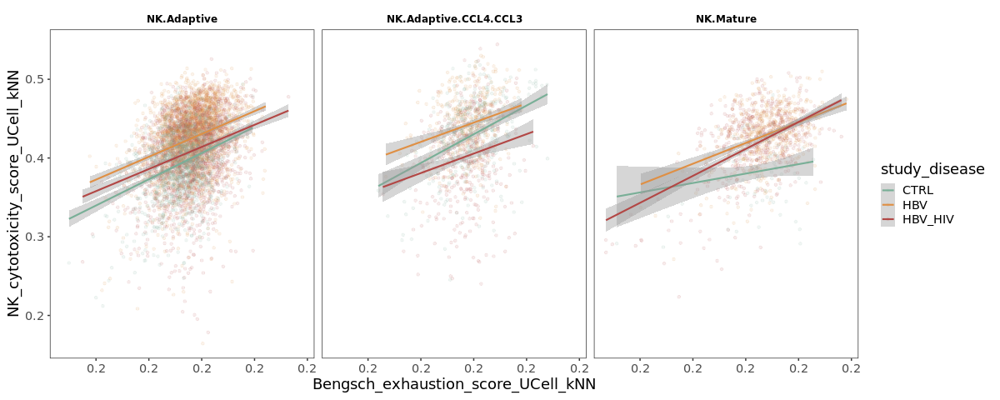

In [27]:
%%R -w 1200
scaleFUN <- function(x) sprintf("%.1f", x)

NK_meta %>%
filter(!grepl("Azimuth", Ref_lab)) %>%
ggplot(aes(Bengsch_exhaustion_score_UCell_kNN, NK_cytotoxicity_score_UCell_kNN, color=study_disease))+
geom_point(alpha=0.1)+
facet_wrap(~celltype_consensus.l2)+
geom_smooth(method="lm")+
scale_x_continuous(labels=scaleFUN)+
scale_color_manual(values = study_cols)


In [28]:
%%R
pdf(file = "/well/immune-rep/users/vbw431/Projects/Peppa/new_out/final_plots/NK_exhaustion_violin.pdf",width = 11,height = 8)
plot(patchwork::wrap_plots(NK_cyto_plot/NK_exh_plot))
dev.off()


[1] 2


## GSEA

In [29]:
import gseapy

In [30]:
##generate pseudobulks
NK.X = NK.layers["counts"].copy()
tmp = NK[NK.obs["celltype_consensus.l2"] != "NK.Prolifering"].copy()
tmp = tmp[tmp.obs["Ref_lab"] != "Azimuth"].copy()

pseudobulks = dc.get_pseudobulk(tmp, sample_col='bio_replicate', 
                                groups_col="celltype_consensus.l1", 
                                layer='counts', min_prop=0.1, min_smpls=3)

# preprocessing
sc.pp.normalize_total(pseudobulks, target_sum=1e4)
sc.pp.log1p(pseudobulks)

# preprocessing
sc.pp.normalize_total(tmp, target_sum=1e4)
sc.pp.log1p(tmp)

In [31]:
##setup custom genesets
genesets = {
        #'Scott': Scott,
  'Bengsch': Bengsch["Hu.ESG"].unique().tolist(),
}


In [32]:
## Set contrasts

contrasts = {
    'HBVvsCTRL': 'HBV_HIV',
    'HBV_HIVvsCTRL': 'HBV',
    'HBVvsHBV_HIV': 'CTRL'

}
    
contrast_class = {
    'HBVvsCTRL': ['HBV', 'CTRL'],
    'HBV_HIVvsCTRL': ['HBV_HIV', 'CTRL'],
    'HBVvsHBV_HIV': ['HBV', 'HBV_HIV']

}
     

In [33]:
##subset to HBV and Co infection
res_list = {}
for i in contrasts:
    NK_totest = tmp[tmp.obs["study_disease"]!=contrasts[i]].copy()
    # set STIM as class 0, CTRL as class 1, to make categorical
    NK_totest.obs['study_disease'] = pd.Categorical(NK_totest.obs['study_disease'], categories=[contrast_class[i][0], contrast_class[i][1]], ordered=True)
    indices = NK_totest.obs.sort_values(['study_disease']).index
    NK_totest = NK_totest[indices,:]
    res = gseapy.gsea(data=NK_totest.to_df().T, # row -> genes, column-> samples
        gene_sets=genesets,
        cls=NK_totest.obs.study_disease,
        permutation_num=1000,
        permutation_type='gene_set',
        outdir=None,
        method='diff_of_classes',
        seed = 5,
        threads=16)
    res_list[i] = res
    
    

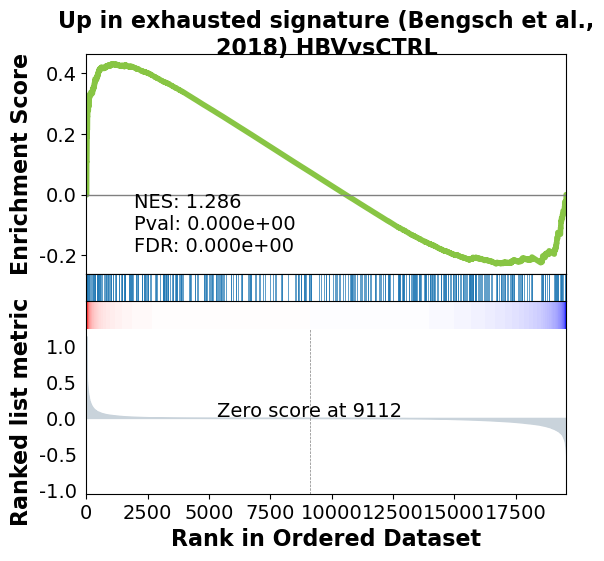

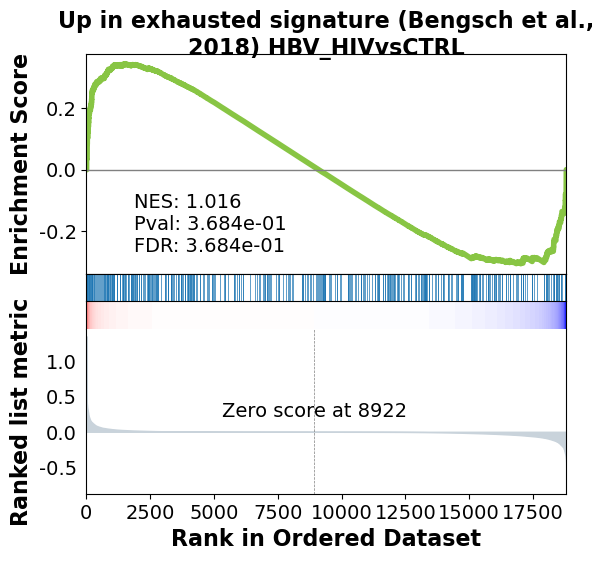

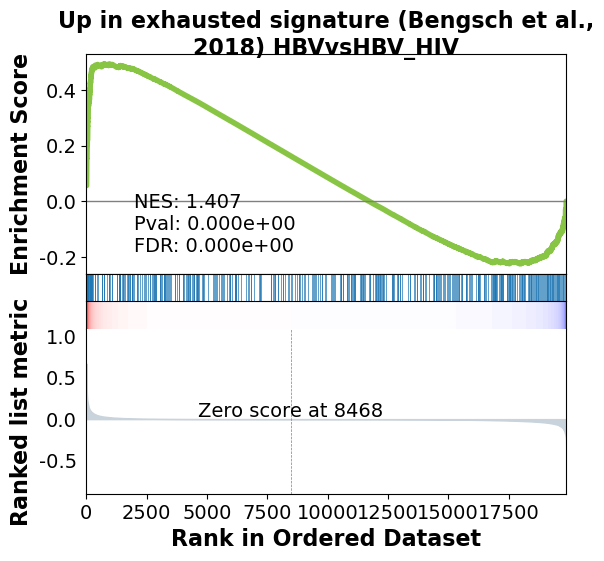

In [34]:
plt.rcParams['figure.figsize'] = [14, 8]

for i in res_list:
    gseapy.gseaplot(res_list[i].ranking, term="Up in exhausted signature (Bengsch et al., 2018) "+i, **res_list[i].results["Bengsch"], ofname = plot_dir+i+"_GSEApy.pdf")
    
for i in res_list:
    gseapy.gseaplot(res_list[i].ranking, term="Up in exhausted signature (Bengsch et al., 2018) "+i, **res_list[i].results["Bengsch"])
    
        
    
    

## Exhaustion markers for CD8 and compare

In [35]:
CD8 = adata_all[adata_all.obs["celltype_consensus"] == "CD8"].copy()


In [36]:
%%R
CD8 <- subset(peppa, subset = celltype_consensus == "CD8")


In [37]:
%%R
##correct for sample size
CD8@meta.data %>%
select(celltype_consensus.l2, study_disease) %>%
table() %>% 
print()

                     study_disease
celltype_consensus.l2 CTRL  HBV HBV_HIV
            CD8.Naive 4631 4522    2057
            CD8.TCM    846  423     569
            CD8.TEM   3100 1155    3550
            CD8.TEMRA 4899 2047    3692
            MAIT      1015  370     200
            MPECs      218  145     115
            gdT        771 1104     210


In [38]:
%%R
##downsample evenly per cell subset per condition


set.seed(1)
CD8naive_barcodes <- CD8@meta.data %>%
mutate(cells = rownames(.)) %>%
filter(grepl("CD8.Naive$", celltype_consensus.l2))%>%
group_by(celltype_consensus.l2, study_disease) %>%
sample_n(2000,replace=FALSE) %>% 
ungroup() %>% 
select(cells) %>% 
unlist()

set.seed(1)
CD8tcm_barcodes <- CD8@meta.data %>%
mutate(cells = rownames(.)) %>%
filter(grepl("CD8.TCM$", celltype_consensus.l2))%>%
group_by(celltype_consensus.l2, study_disease) %>%
sample_n(400,replace=FALSE) %>% 
ungroup() %>% 
select(cells) %>% 
unlist()

set.seed(1)
CD8tem_barcodes <- CD8@meta.data %>%
mutate(cells = rownames(.)) %>%
filter(grepl("CD8.TEM$", celltype_consensus.l2))%>%
group_by(celltype_consensus.l2, study_disease) %>%
sample_n(1000,replace=FALSE) %>% 
ungroup() %>% 
select(cells) %>% 
unlist()

set.seed(1)
CD8temra_barcodes <- CD8@meta.data %>%
mutate(cells = rownames(.)) %>%
filter(grepl("CD8.TEMRA$", celltype_consensus.l2))%>%
group_by(celltype_consensus.l2, study_disease) %>%
sample_n(2000,replace=FALSE) %>% 
ungroup() %>% 
select(cells) %>% 
unlist()

set.seed(1)
CD8mait_barcodes <- CD8@meta.data %>%
mutate(cells = rownames(.)) %>%
filter(grepl("MAIT$", celltype_consensus.l2))%>%
group_by(celltype_consensus.l2, study_disease) %>%
sample_n(200,replace=FALSE) %>% 
ungroup() %>% 
select(cells) %>% 
unlist()

set.seed(1)
CD8gdT_barcodes <- CD8@meta.data %>%
mutate(cells = rownames(.)) %>%
filter(grepl("gdT$", celltype_consensus.l2))%>%
group_by(celltype_consensus.l2, study_disease) %>%
sample_n(200,replace=FALSE) %>% 
ungroup() %>% 
select(cells) %>% 
unlist()

CD8MPECs_barcodes <- CD8@meta.data %>%
mutate(cells = rownames(.)) %>%
filter(grepl("MPECs$", celltype_consensus.l2))%>%
group_by(celltype_consensus.l2, study_disease) %>%
sample_n(100,replace=FALSE) %>% 
ungroup() %>% 
select(cells) %>% 
unlist()

downsample_cells <- c(CD8MPECs_barcodes,
                     CD8gdT_barcodes,
                     CD8mait_barcodes,
                     CD8temra_barcodes,
                     CD8tem_barcodes,
                     CD8tcm_barcodes,
                     CD8naive_barcodes
                     )

CD8 <- subset(CD8, cells = downsample_cells)


In [39]:
CD8_scvi = scvi_list["CD8"]

In [40]:
%%R -i CD8_scvi

CD8_scvi <- CD8_scvi[rownames(CD8_scvi) %in% colnames(CD8),]
CD8_scvi <- as.matrix(CD8_scvi)
colnames(CD8_scvi) <- as.integer(colnames(CD8_scvi))+1
colnames(CD8_scvi)

CD8[["scvi"]]<- CreateDimReducObject(embeddings = CD8_scvi, global = T,key = "scvi_", assay = "RNA")


CD8 <- SmoothKNN(CD8, signature.names = paste0(names(score_list),"_UCell"), reduction="scvi")

CD8_meta <- CD8@meta.data

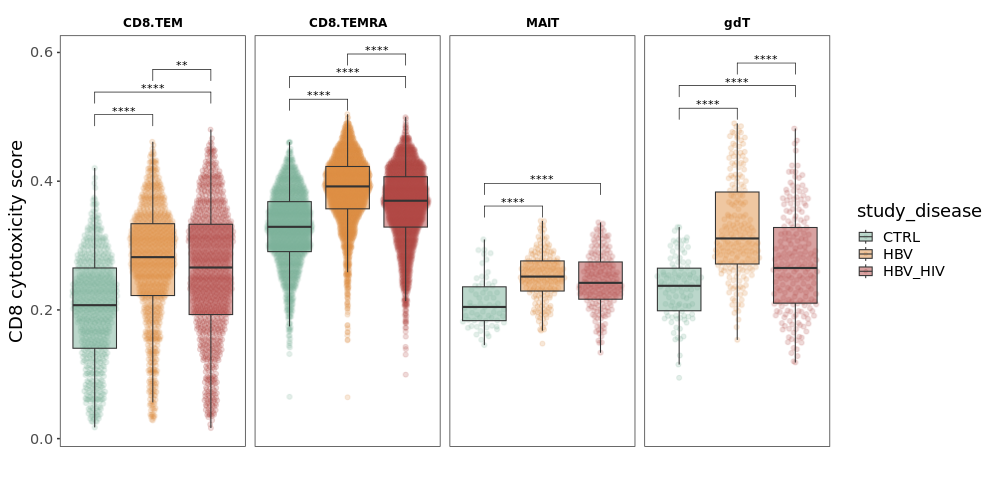

In [41]:
%%R -w 1000

##Cytotoxicity 
study_cols <-  c("CTRL"="#79AF97FF","HBV"="#DF8F44FF", "HBV_HIV" = "#B24745FF" )

CD8_cyto_dunn <- CD8_meta %>%
filter(!grepl("Pre", Treatment_status)) %>%
filter(!grepl("Azimuth", Ref_lab)) %>%
filter(!grepl("CD8.Naive|CD8.TCM|MPECs$", celltype_consensus.l2)) %>%
group_by(celltype_consensus.l2) %>% 
ungroup() %>%
select(celltype_consensus.l2,study_disease, 
       NK_cytotoxicity_score_UCell_kNN) %>%
reshape2::melt(id.vars=c("celltype_consensus.l2", "study_disease")) %>% 
group_by(celltype_consensus.l2, study_disease, variable) %>%
ungroup() %>%
group_by(celltype_consensus.l2) %>% 
dunn_test(value~study_disease) %>%
add_xy_position()

CD8_cyto_plot<-CD8_meta %>%
filter(!grepl("Pre", Treatment_status)) %>%
filter(!grepl("Azimuth", Ref_lab)) %>%
filter(!grepl("CD8.Naive|CD8.TCM|MPECs$", celltype_consensus.l2)) %>%
select(celltype_consensus.l2,study_disease, 
       NK_cytotoxicity_score_UCell_kNN) %>%
reshape2::melt(id.vars=c("celltype_consensus.l2", "study_disease")) %>% 
group_by(celltype_consensus.l2, study_disease, variable) %>%
ggplot(aes(study_disease, value))+
ggrastr::rasterise(geom_quasirandom(aes(color=study_disease),alpha=0.2))+
geom_boxplot(aes(fill = study_disease),outlier.alpha=0, alpha=0.5)+
facet_wrap(~celltype_consensus.l2, ncol=4)+
xlab("")+
ylab("CD8 cytotoxicity score")+
theme(axis.text.x = element_blank(), axis.ticks.x = element_blank())+
scale_fill_manual(values = study_cols)+ 
scale_color_manual(values = study_cols)+ 
ggpubr::stat_pvalue_manual(CD8_cyto_dunn %>% filter(p.adj.signif!= "ns"))

print(CD8_cyto_plot)



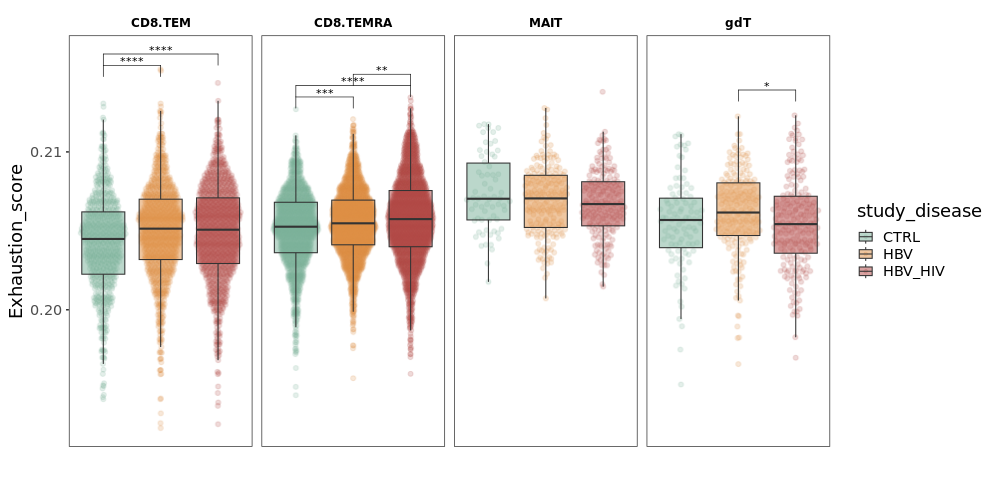

In [42]:
%%R -w 1000

CD8_exh_dunn <- CD8_meta %>%
filter(!grepl("Pre", Treatment_status)) %>%
filter(!grepl("Azimuth", Ref_lab)) %>%
filter(!grepl("CD8.Naive|CD8.TCM|MPECs$", celltype_consensus.l2)) %>%
group_by(celltype_consensus.l2) %>% 
ungroup() %>%
select(celltype_consensus.l2,study_disease, 
       Bengsch_exhaustion_score_UCell_kNN) %>%
reshape2::melt(id.vars=c("celltype_consensus.l2", "study_disease")) %>% 
group_by(celltype_consensus.l2, study_disease, variable) %>%
ungroup() %>%
group_by(celltype_consensus.l2) %>% 
dunn_test(value~study_disease) %>%
add_xy_position()

CD8_exh_plot<-CD8_meta %>%
filter(!grepl("Pre", Treatment_status)) %>%
filter(!grepl("Azimuth", Ref_lab)) %>%
filter(!grepl("CD8.Naive|CD8.TCM|MPECs$", celltype_consensus.l2)) %>%
select(celltype_consensus.l2,study_disease, 
       Bengsch_exhaustion_score_UCell_kNN) %>%
reshape2::melt(id.vars=c("celltype_consensus.l2", "study_disease")) %>% 
group_by(celltype_consensus.l2, study_disease, variable) %>%
ggplot(aes(study_disease, value))+
ggrastr::rasterise(geom_quasirandom(aes(color=study_disease),alpha=0.2))+
geom_boxplot(aes(fill = study_disease),outlier.alpha=0, alpha=0.5)+
facet_wrap(~celltype_consensus.l2, ncol=4)+
xlab("")+
ylab("Exhaustion_score")+
theme(axis.text.x = element_blank(), axis.ticks.x = element_blank())+
scale_fill_manual(values = study_cols)+ 
scale_color_manual(values = study_cols)+ 
ggpubr::stat_pvalue_manual(CD8_exh_dunn %>% filter(p.adj.signif!= "ns"))



print(CD8_exh_plot)




In [43]:
%%R
pdf(file = "/well/immune-rep/users/vbw431/Projects/Peppa/new_out/final_plots/CD8_exhaustion_violin.pdf",width = 9,height = 10)
plot(patchwork::wrap_plots(CD8_exh_plot/CD8_cyto_plot))
dev.off()


[1] 2


In [44]:
%%R
##save both as panels
library(patchwork)
pdf(file = "/well/immune-rep/users/vbw431/Projects/Peppa/new_out/final_plots/all_exhaustion_violin.pdf",width = 20,height = 10)
plot(CD8_cyto_plot+NK_cyto_plot+CD8_exh_plot+NK_exh_plot+plot_layout(widths = c(2, 1.6)))
dev.off()



[1] 2


## Create umap visualisations

In [45]:
umap_cd8 = pd.DataFrame(CD8.obsm["X_umap"], index=CD8.obs_names)
NK_umap = pd.DataFrame(NK.obsm["X_umap"], index=NK.obs_names)

In [46]:
%%R -i umap_cd8
umap_cd8 = as.data.frame(umap_cd8)
colnames(umap_cd8) = c("UMAP_1", "UMAP_2")
umap_cd8 <- umap_cd8[rownames(umap_cd8) %in% colnames(CD8),]
umap_cd8$barcode <- rownames(umap_cd8)
print(head(umap_cd8))

CD8_meta <- CD8@meta.data
print(head(CD8_meta))

CD8_meta <- CD8_meta %>% left_join(umap_cd8, by = c("barcodes" = "barcode"))


                              UMAP_1    UMAP_2                     barcode
AAACCTGCAGAGCCAA-1-HIVHBV_C 9.455333 11.083461 AAACCTGCAGAGCCAA-1-HIVHBV_C
AAACCTGGTAGGGACT-1-HIVHBV_C 8.636454 11.453134 AAACCTGGTAGGGACT-1-HIVHBV_C
AAACCTGTCAAGATCC-1-HIVHBV_C 4.795305  6.117670 AAACCTGTCAAGATCC-1-HIVHBV_C
AAACGGGCATCAGTCA-1-HIVHBV_C 9.697214 10.166738 AAACGGGCATCAGTCA-1-HIVHBV_C
AAAGATGGTCTGCGGT-1-HIVHBV_C 7.593818  4.359899 AAAGATGGTCTGCGGT-1-HIVHBV_C
AAAGATGGTGGTCCGT-1-HIVHBV_C 6.435214  2.529672 AAAGATGGTGGTCCGT-1-HIVHBV_C
                               orig.ident nCount_RNA nFeature_RNA sample_ID
AAACCTGCAGAGCCAA-1-HIVHBV_C SeuratProject   2309.010         1375  HIVHBV_C
AAACCTGGTAGGGACT-1-HIVHBV_C SeuratProject   1980.718          947  HIVHBV_C
AAACCTGTCAAGATCC-1-HIVHBV_C SeuratProject   2585.324         1522  HIVHBV_C
AAACGGGCATCAGTCA-1-HIVHBV_C SeuratProject   2747.449         1570  HIVHBV_C
AAAGATGGTCTGCGGT-1-HIVHBV_C SeuratProject   2460.064         1555  HIVHBV_C
AAAGATGGTGGTCCGT-1-

AAACCTGCAGAGCCAA-1-HIVHBV_C        NaN          NaN <NA>  <NA> <NA>        <NA>
AAACCTGGTAGGGACT-1-HIVHBV_C        NaN          NaN <NA>  <NA> <NA>        <NA>
AAACCTGTCAAGATCC-1-HIVHBV_C        NaN          NaN <NA>  <NA> <NA>        <NA>
AAACGGGCATCAGTCA-1-HIVHBV_C        NaN          NaN <NA>  <NA> <NA>        <NA>
AAAGATGGTCTGCGGT-1-HIVHBV_C        NaN          NaN <NA>  <NA> <NA>        <NA>
AAAGATGGTGGTCCGT-1-HIVHBV_C        NaN          NaN <NA>  <NA> <NA>        <NA>
                            celltype.l2 celltype.l3 nCount_SCT nFeature_SCT
AAACCTGCAGAGCCAA-1-HIVHBV_C        <NA>        <NA>        NaN          NaN
AAACCTGGTAGGGACT-1-HIVHBV_C        <NA>        <NA>        NaN          NaN
AAACCTGTCAAGATCC-1-HIVHBV_C        <NA>        <NA>        NaN          NaN
AAACGGGCATCAGTCA-1-HIVHBV_C        <NA>        <NA>        NaN          NaN
AAAGATGGTCTGCGGT-1-HIVHBV_C        <NA>        <NA>        NaN          NaN
AAAGATGGTGGTCCGT-1-HIVHBV_C        <NA>        <NA>        NaN  

AAAGATGGTCTGCGGT-1-HIVHBV_C                        0.2473136
AAAGATGGTGGTCCGT-1-HIVHBV_C                        0.2450009
                            NK_cytotoxicity_score_UCell_kNN
AAACCTGCAGAGCCAA-1-HIVHBV_C                      0.29281022
AAACCTGGTAGGGACT-1-HIVHBV_C                      0.35910838
AAACCTGTCAAGATCC-1-HIVHBV_C                      0.01747558
AAACGGGCATCAGTCA-1-HIVHBV_C                      0.32079353
AAAGATGGTCTGCGGT-1-HIVHBV_C                      0.18077729
AAAGATGGTGGTCCGT-1-HIVHBV_C                      0.27814545
                            T_cell_exhaustion_score_UCell_kNN
AAACCTGCAGAGCCAA-1-HIVHBV_C                        0.01460546
AAACCTGGTAGGGACT-1-HIVHBV_C                        0.01252627
AAACCTGTCAAGATCC-1-HIVHBV_C                        0.00230994
AAACGGGCATCAGTCA-1-HIVHBV_C                        0.03200249
AAAGATGGTCTGCGGT-1-HIVHBV_C                        0.01742039
AAAGATGGTGGTCCGT-1-HIVHBV_C                        0.02187584


In [47]:
%%R -i NK_umap
NK_umap = as.data.frame(NK_umap)
colnames(NK_umap) = c("UMAP_1", "UMAP_2")

NK_umap <- NK_umap[rownames(NK_umap) %in% colnames(NK),]
NK_umap$barcode <- rownames(NK_umap)

NK_meta <- NK@meta.data
NK_meta <- NK_meta %>% left_join(NK_umap, by = c("barcodes" = "barcode"))


In [48]:
%%R
NK_meta %>% head()

     orig.ident nCount_RNA nFeature_RNA sample_ID nCount_HTO nFeature_HTO
1 SeuratProject   2508.859         1259  HIVHBV_C        260            2
2 SeuratProject   2921.987         2053  HIVHBV_C        733            2
3 SeuratProject   2819.482         2175  HIVHBV_C        570            2
4 SeuratProject   2773.429         1649  HIVHBV_C       1193            2
5 SeuratProject   2699.850         1657  HIVHBV_C       3162            2
6 SeuratProject   2513.127         1455  HIVHBV_C        744            2
  HTO_maxID HTO_secondID HTO_margin HTO_classification
1 Hashtag-2    Hashtag-1  0.8217422          Hashtag-2
2 Hashtag-2    Hashtag-1  1.0738127          Hashtag-2
3 Hashtag-2    Hashtag-1  1.2243232          Hashtag-2
4 Hashtag-2    Hashtag-1  1.2693868          Hashtag-2
5 Hashtag-1    Hashtag-2  2.1377305          Hashtag-1
6 Hashtag-1    Hashtag-2  0.8403261          Hashtag-1
  HTO_classification.global   hash.ID percent.mt percent.ribo percent.Ig
1                   Sing

                     barcodes Bengsch_exhaustion_score_UCell
1 AAACCTGTCGCATGGC-1-HIVHBV_C                      0.2164583
2 AAACGGGAGATATACG-1-HIVHBV_C                      0.2218840
3 AAACGGGAGTTACCCA-1-HIVHBV_C                      0.2050462
4 AAACGGGCATCGGTTA-1-HIVHBV_C                      0.2256590
5 AAAGATGTCTCGCTTG-1-HIVHBV_C                      0.2118538
6 AAAGCAAAGCGTTCCG-1-HIVHBV_C                      0.2117359
  Scott_exhaustion_score_UCell NK_cytotoxicity_score_UCell
1                    0.2603039                   0.2180000
2                    0.2462130                   0.5261481
3                    0.2446825                   0.4914444
4                    0.2591356                   0.4655926
5                    0.2531727                   0.3453704
6                    0.2590850                   0.4078148
  T_cell_exhaustion_score_UCell Bengsch_exhaustion_score_UCell_kNN
1                    0.07142857                          0.2076958
2                    0.029

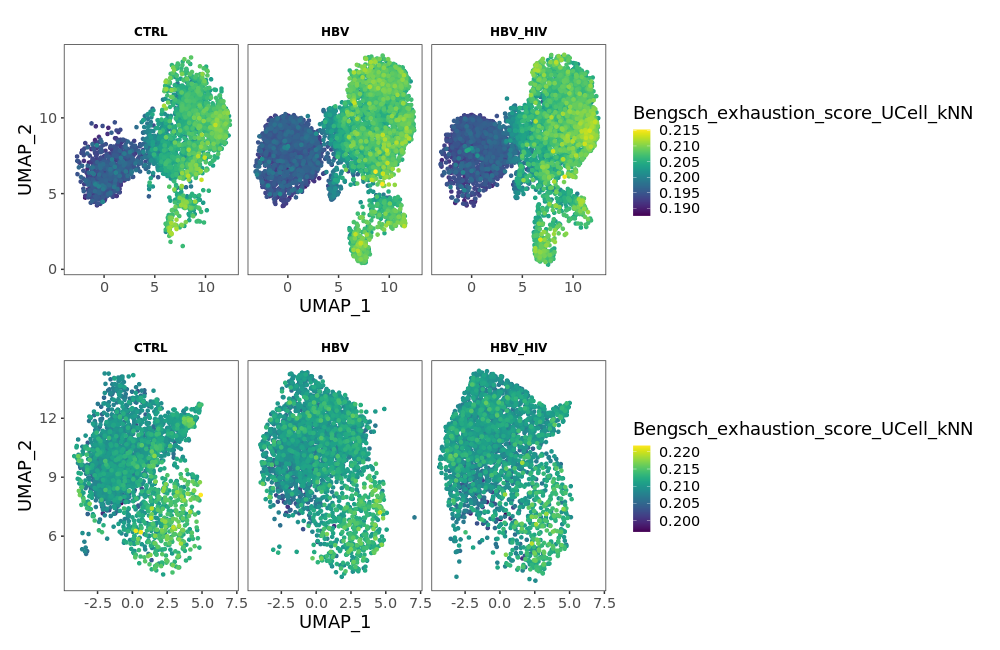

In [49]:
%%R -w 1000 -h 650 
NK_exhaus_heat <-NK_meta %>%
filter(!grepl("Pre", Treatment_status)) %>%
#filter(!grepl("Azimuth", Ref_lab)) %>%
arrange((Bengsch_exhaustion_score_UCell_kNN)) %>%
ggplot(aes(UMAP_1, UMAP_2))+
geom_point(aes(color = Bengsch_exhaustion_score_UCell_kNN))+
viridis::scale_color_viridis()+
facet_wrap(~study_disease)

CD8_exhaus_heat <-CD8_meta %>%
filter(!grepl("Pre", Treatment_status)) %>%
filter(!grepl("Azimuth", Ref_lab)) %>%
arrange((Bengsch_exhaustion_score_UCell_kNN)) %>%
ggplot(aes(UMAP_1, UMAP_2))+
geom_point(aes(color = Bengsch_exhaustion_score_UCell_kNN))+
viridis::scale_color_viridis()+
facet_wrap(~study_disease)

patchwork::wrap_plots(CD8_exhaus_heat/NK_exhaus_heat)

In [50]:
%%R

NK_mat <-NK_meta %>%
filter(!grepl("Pre", Treatment_status)) %>%
filter(!grepl("Azimuth", Ref_lab)) %>%
select(study_disease, celltype_consensus.l2,Bengsch_exhaustion_score_UCell_kNN) %>%
group_by(study_disease,celltype_consensus.l2) %>%
summarise(across(everything(), mean)) %>%
mutate(Bengsch_exhaustion_score_UCell_kNN = (Bengsch_exhaustion_score_UCell_kNN))%>%
ungroup() %>%
reshape2::acast(., celltype_consensus.l2~study_disease, value.var="Bengsch_exhaustion_score_UCell_kNN")
NK_mat <- as.matrix(NK_mat)



`summarise()` has grouped output by 'study_disease'. You can override using the
`.groups` argument.


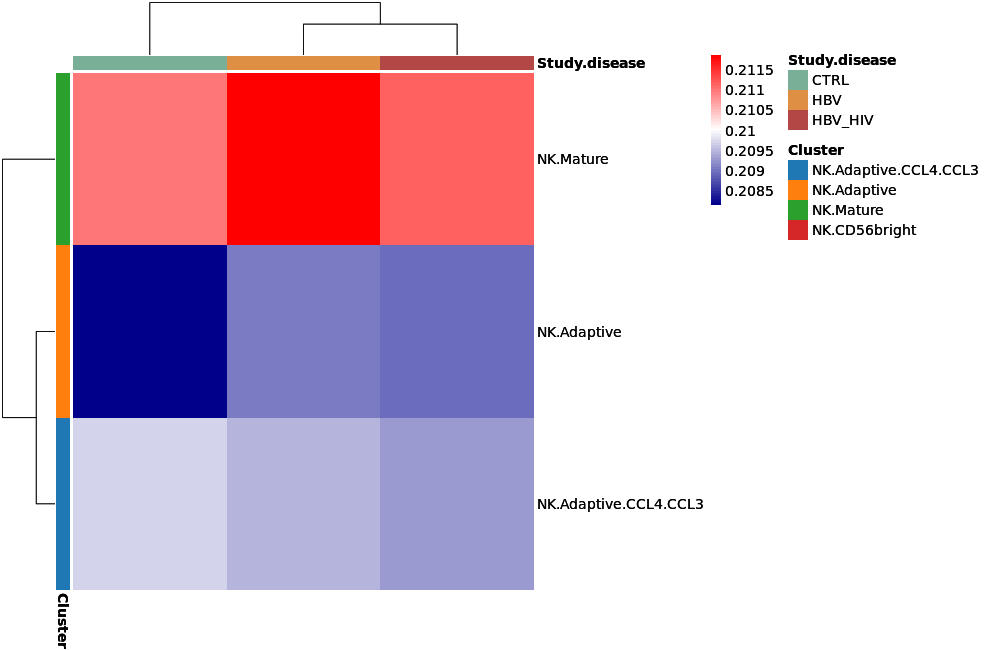

In [51]:
%%R -w 1000 -h 650 
# Data frame with column annotations.
# Data frame with column annotations.

mat_col <- data.frame(`Study.disease` = colnames(NK_mat))
rownames(mat_col) <- colnames(NK_mat)


# List with colors for each annotation.
#mat_colors <- list(group = brewer.pal(3, "Set1"))
#names(mat_colors$group) <- unique(col_groups)
annot_colors=list(Cluster=c(NK.Adaptive.CCL4.CCL3 = "#1F77B4FF",
                           NK.Adaptive = "#FF7F0EFF",
                           NK.Mature = "#2CA02CFF",
                           NK.CD56bright = "#D62728FF" 
                           #NK.Prolifering = "#9467BDFF"
                           ), 
                 `Study.disease` = c(CTRL="#79AF97FF",
                                  HBV="#DF8F44FF",
                                  HBV_HIV = "#B24745FF" ))

sub_anno <- data.frame(`Cluster` = rownames(NK_mat))
rownames(sub_anno) <- rownames(NK_mat)


# 2) plot heatmap with no row clusters

heatmap_reactome <- pheatmap::pheatmap(
  mat               = NK_mat,
  border_color      = NA,
  show_colnames     = FALSE,
    show_rownames     = T,
    #labels_row = goi,
    annotation_row = sub_anno,
  annotation_col    = mat_col,
  annotation_colors = annot_colors,
  drop_levels       = TRUE,
annotation_names_col = TRUE, 
  fontsize          = 14,
    cluster_rows = T,
    color = colorRampPalette(c("Darkblue", "white","red"))(100),
)

print(heatmap_reactome)


In [52]:
%%R
CD8_mat <-CD8_meta %>%
filter(!grepl("Pre", Treatment_status)) %>%
filter(!grepl("Azimuth", Ref_lab)) %>%
filter(!grepl("CD8.Naive|CD8.TCM|MPECs$", celltype_consensus.l2)) %>%
select(study_disease, celltype_consensus.l2,Bengsch_exhaustion_score_UCell_kNN) %>%
group_by(study_disease,celltype_consensus.l2) %>%
summarise(across(everything(), mean)) %>%
mutate(Bengsch_exhaustion_score_UCell_kNN = (Bengsch_exhaustion_score_UCell_kNN))%>%
ungroup() %>%
reshape2::acast(., celltype_consensus.l2~study_disease, value.var="Bengsch_exhaustion_score_UCell_kNN")
CD8_mat <- as.matrix(CD8_mat)
print(CD8_mat)

`summarise()` has grouped output by 'study_disease'. You can override using the
`.groups` argument.
               CTRL       HBV   HBV_HIV
CD8.TEM   0.2042033 0.2049675 0.2049173
CD8.TEMRA 0.2051002 0.2055097 0.2057400
MAIT      0.2073651 0.2069076 0.2067165
gdT       0.2054597 0.2061074 0.2054392


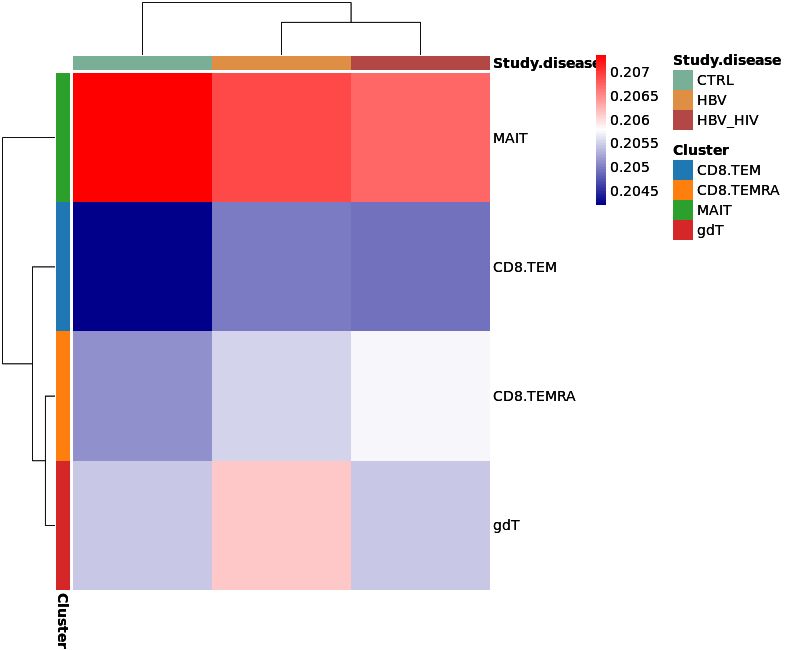

In [53]:
%%R -w 800 -h 650 
# Data frame with column annotations.
# Data frame with column annotations.

mat_col <- data.frame(`Study.disease` = colnames(CD8_mat))
rownames(mat_col) <- colnames(CD8_mat)


# List with colors for each annotation.
#mat_colors <- list(group = brewer.pal(3, "Set1"))
#names(mat_colors$group) <- unique(col_groups)
annot_colors=list(Cluster=c(CD8.TEM = "#1F77B4FF",
                           CD8.TEMRA = "#FF7F0EFF",
                           MAIT = "#2CA02CFF",
                           gdT = "#D62728FF" 
                           ), 
                 `Study.disease` = c(CTRL="#79AF97FF",
                                  HBV="#DF8F44FF",
                                  HBV_HIV = "#B24745FF" ))

sub_anno <- data.frame(`Cluster` = rownames(CD8_mat))
rownames(sub_anno) <- rownames(CD8_mat)


# 2) plot heatmap with no row clusters

heatmap_CD8 <- pheatmap::pheatmap(
  mat               = CD8_mat,
  border_color      = NA,
  show_colnames     = FALSE,
    show_rownames     = T,
    #labels_row = goi,
    annotation_row = sub_anno,
  annotation_col    = mat_col,
  annotation_colors = annot_colors,
  drop_levels       = TRUE,
annotation_names_col = TRUE, 
  fontsize          = 14,
    cluster_rows = T,
    color = colorRampPalette(c("Darkblue", "white","red"))(100),
)

print(heatmap_CD8)

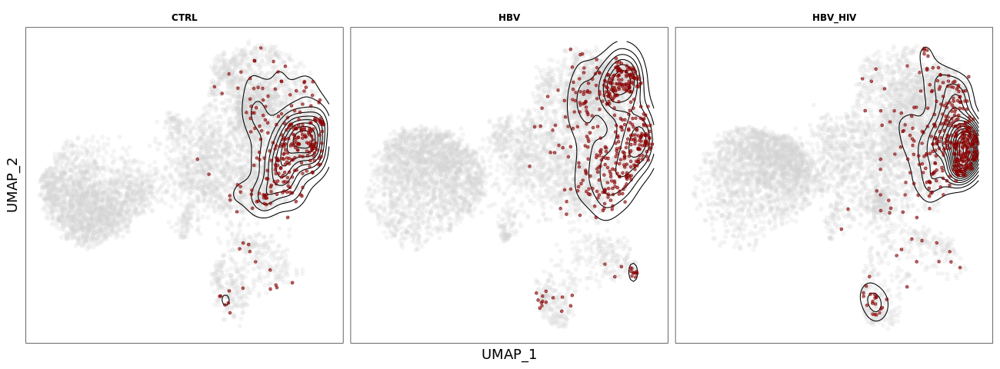

In [54]:
%%R -w 1300

CD8_exh_umap <- CD8_meta %>%
group_by(bio_replicate) %>% 
ggplot(aes(UMAP_1, UMAP_2))+
ggrastr::rasterize(geom_point(color="light gray", alpha=0.2))+
geom_density2d(data = CD8_meta %>% filter(T_cell_exhaustion_score_UCell_kNN>0.05), color = "black", bins = 15)+
geom_point(data = CD8_meta %>% filter(T_cell_exhaustion_score_UCell_kNN>0.05),color="dark red", alpha=0.6)+
facet_wrap(~study_disease)+
theme(axis.text=element_blank(), axis.ticks = element_blank())

CD8_exh_umap


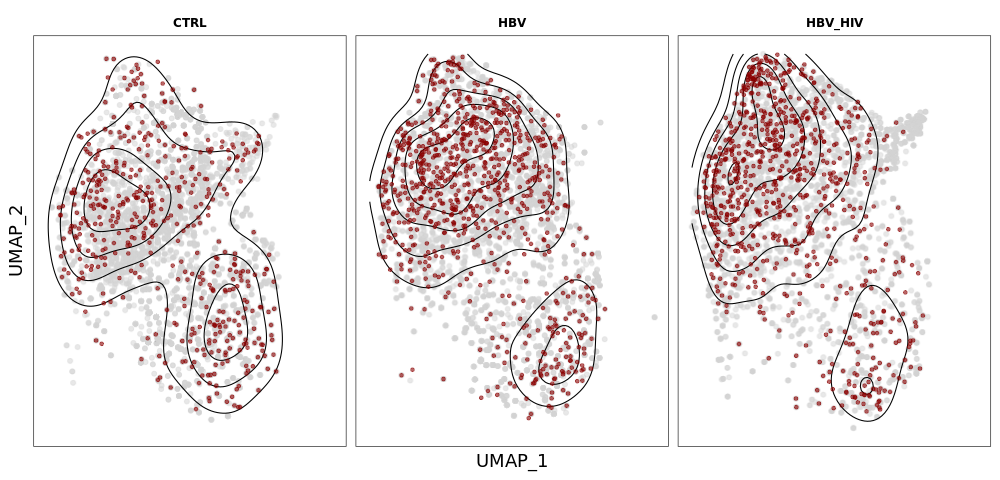

In [55]:
%%R -w 1000
NK_exh_umap <- NK_meta %>%
group_by(bio_replicate) %>% 
sample_n(1000, replace=TRUE)%>%
ggplot(aes(UMAP_1, UMAP_2))+
ggrastr::rasterize(geom_point(color="light gray", alpha=0.5))+
geom_density2d(data = NK_meta %>% filter(T_cell_exhaustion_score_UCell_kNN>0.06), color = "black", bins = 6)+
geom_point(data = NK_meta %>% filter(T_cell_exhaustion_score_UCell_kNN>0.06),color="dark red", alpha=0.6)+
facet_wrap(~study_disease)+
theme(axis.text=element_blank(), axis.ticks = element_blank())

NK_exh_umap

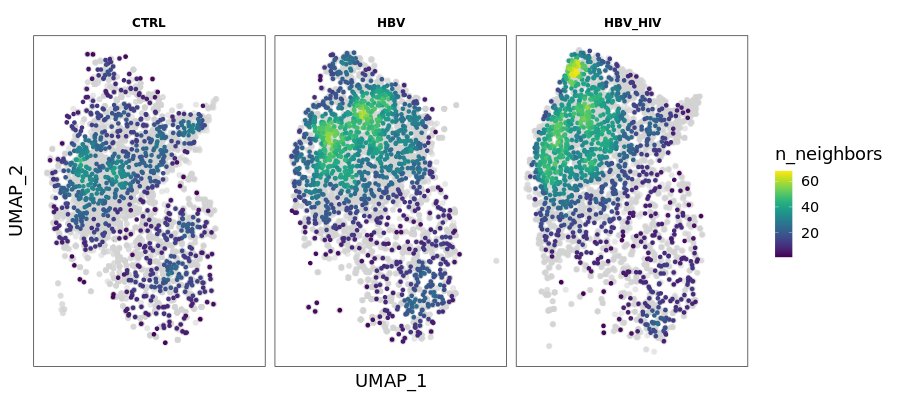

In [56]:
%%R -w 900 -h 400
library(ggpointdensity)
NK_exh_umap <- NK_meta %>%
group_by(bio_replicate) %>% 
sample_n(2000, replace=TRUE)%>%
ggplot(aes(UMAP_1, UMAP_2))+
ggrastr::rasterize(geom_point(color="light gray", alpha=0.5))+
geom_pointdensity(data = NK_meta %>% filter(T_cell_exhaustion_score_UCell_kNN>0.05))+
facet_wrap(~study_disease)+
viridis::scale_color_viridis()+
theme(axis.text=element_blank(), axis.ticks = element_blank())

NK_exh_umap

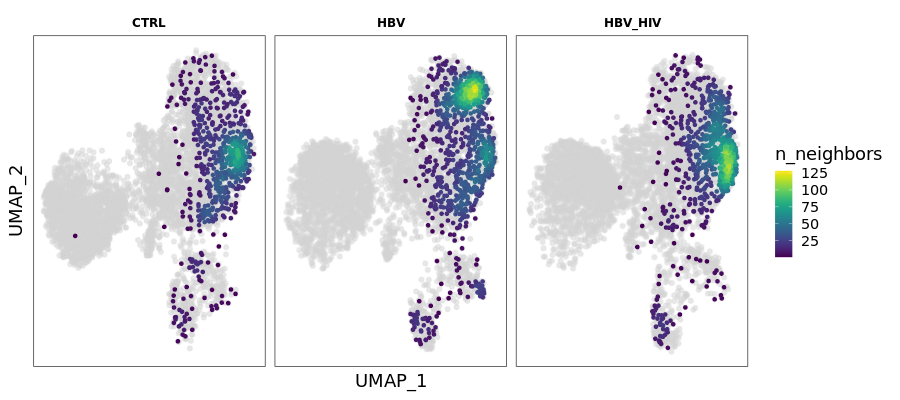

In [57]:
%%R -w 900 -h 400

CD8_exh_umap <- CD8_meta %>%
group_by(bio_replicate) %>% 
ggplot(aes(UMAP_1, UMAP_2))+
ggrastr::rasterize(geom_point(color="light gray", alpha=0.5))+
geom_pointdensity(data = CD8_meta %>% filter(T_cell_exhaustion_score_UCell_kNN>0.04))+
facet_wrap(~study_disease)+
viridis::scale_color_viridis()+
theme(axis.text=element_blank(), axis.ticks = element_blank())

CD8_exh_umap

In [58]:
%%R
pdf(file = "/well/immune-rep/users/vbw431/Projects/Peppa/new_out/final_plots/Exhaustion_umap.pdf",width = 20,height = 4)
plot(patchwork::wrap_plots(CD8_exh_umap|NK_exh_umap))
dev.off()

[1] 2


In [59]:
sc.set_figure_params(vector_friendly=True, dpi=500,fontsize=14,dpi_save=500, figsize = (5,4))
sc.pl.umap(CD8, color=["TOX", "LAG3","PDCD1", "TIGIT"], cmap='Reds', size=20,save = "CD8_exh_genes.pdf")


In [60]:
np.max(NK.layers["counts"])
NK.X = NK.layers["counts"].copy()
sc.pp.normalize_total(NK, target_sum=1e4)
sc.pp.log1p(NK)

sc.set_figure_params(vector_friendly=True, dpi=500,fontsize=14,dpi_save=500, figsize = (5,4))
sc.pl.umap(NK, color=["TOX", "LAG3","PDCD1", "TIGIT"],cmap='Reds', size=20, save = "NK_exh_genes.pdf")


## Clinical correlations
Need to update with new table*

In [61]:
%%R
NK_full <- subset(peppa, subset = celltype_consensus.l1 == "NK")


NK_to_cor <- NK_full@meta.data %>%
filter(!grepl("3|7", time)) %>%
group_by(bio_replicate, Treatment_status, study_disease) %>%
add_tally(name = "Total_NK") %>%
ungroup() %>%
group_by(bio_replicate, study_disease,Treatment_status, celltype_consensus.l2) %>%
add_tally(name= "Subset_NK") %>%
ungroup() %>%
mutate(proportion_NK = Subset_NK/Total_NK) 



In [62]:
%%R
clin_cor <- read.csv("/gpfs3/well/immune-rep/users/vbw431/Projects/Peppa/data/peppa_clin_corr.csv")
head(clin_cor)

clin_cor <- clin_cor %>%
rename(Total_NK_facs = Total_NK)

In [63]:
%%R
NK_to_cor <- NK_to_cor %>%
left_join(clin_cor, by=c("bio_replicate"))
colnames(NK_to_cor)

  [1] "orig.ident"                      "nCount_RNA"                     
  [3] "nFeature_RNA"                    "sample_ID"                      
  [5] "nCount_HTO"                      "nFeature_HTO"                   
  [7] "HTO_maxID"                       "HTO_secondID"                   
  [9] "HTO_margin"                      "HTO_classification"             
 [11] "HTO_classification.global"       "hash.ID"                        
 [13] "percent.mt"                      "percent.ribo"                   
 [15] "percent.Ig"                      "S.Score"                        
 [17] "G2M.Score"                       "Phase"                          
 [19] "CITE_present"                    "nCount_CITE"                    
 [21] "nFeature_CITE"                   "nCount_protein_counts"          
 [23] "nFeature_protein_counts"         "Hashtag.1"                      
 [25] "Hashtag.2"                       "QC_label"                       
 [27] "most_likely_hypothesis"        

In [64]:
%%R -w 1000
library(corrplot)

NK_to_cor %>%
filter(!grepl("CTRL", study_disease)) %>%
select(Age, bio_replicate, study_disease,celltype_consensus.l2, proportion_NK, HBV_sAg_titre) %>%
unique() %>% head

# A tibble: 6 x 6
    Age bio_replicate study_disease celltype_consensus.l2 proportion_NK
  <dbl> <chr>         <chr>         <chr>                         <dbl>
1    44 patient_10    HBV_HIV       NK.Adaptive                  0.689 
2    44 patient_10    HBV_HIV       NK.CD56bright                0.130 
3    44 patient_10    HBV_HIV       NK.Mature                    0.0444
4    44 patient_10    HBV_HIV       NK.Adaptive.CCL4.CCL3        0.120 
5    44 patient_10    HBV_HIV       NK.Prolifering               0.0158
6    46 patient_4     HBV           NK.Adaptive                  0.267 
# i 1 more variable: HBV_sAg_titre <dbl>


In [65]:
%%R
Median_score_df <- NK_to_cor %>% select(bio_replicate,
                     AGE, 
                     study_disease, 
                     HBSAG,
                     HBV_DNA_IU_mL, 
                    HBV_RNA._U_mL,
                    ALT,
                    Total_NK_facs,
                                        Total_NK,
                    CD56dim,CD56BRIGH,                      
                    CD56.NEG,
                    CD2,
                                        CD16,
                                        CD16.MFI,
                                        CD38,
                                        CD57,
                                        FCERG,
                                        GNZB,
                                        IKIRS,
                                        NKG2A,
                                        NKG2C,
                                        CD57HI_NKG2C,
                                        SIGLEC7,
                                        celltype_consensus.l2, 
                    Bengsch_exhaustion_score_UCell,
                    NK_cytotoxicity_score_UCell,
                    proportion_NK) %>% 
                    reshape2::melt(id.vars=c("bio_replicate", 
                                            "AGE", 
                     "study_disease", 
                     "HBSAG",
                     "HBV_DNA_IU_mL", 
                    "HBV_RNA._U_mL",
                    "ALT",
                    "Total_NK_facs",
                                             "Total_NK",
                    "CD56dim",
                    "CD56BRIGH",                      
                    "CD56.NEG",
                    "CD2",
                                        "CD16",
                                        "CD16.MFI",
                                        "CD38",
                                        "CD57",
                                        "FCERG",
                                        "GNZB",
                                        "IKIRS",
                                        "NKG2A",
                                        "NKG2C",
                                        "CD57HI_NKG2C",
                                        "SIGLEC7",
                                        "celltype_consensus.l2",
                                             "proportion_NK"
                                            )) %>% 
                    group_by(bio_replicate,
                     AGE, 
                     study_disease, 
                     HBSAG,
                     HBV_DNA_IU_mL, 
                    HBV_RNA._U_mL,
                    ALT,
                    Total_NK_facs,
                             Total_NK,
                    CD56dim,CD56BRIGH,                      
                    CD56.NEG,
                    CD2,
                                        CD16,
                                        CD16.MFI,
                                        CD38,
                                        CD57,
                                        FCERG,
                                        GNZB,
                                        IKIRS,
                                        NKG2A,
                                        NKG2C,
                                        CD57HI_NKG2C,
                                        SIGLEC7, 
                     celltype_consensus.l2,
                             proportion_NK,
                             variable) %>%
                    dplyr::summarise(`Median score`=median(value)) %>%
                    ungroup() %>%
                    spread(variable, `Median score`) %>%
filter(!grepl("CTRL", study_disease)) %>%
select(-bio_replicate) %>%
unique() %>%
ungroup()



`summarise()` has grouped output by 'bio_replicate', 'AGE', 'study_disease',
'HBSAG', 'HBV_DNA_IU_mL', 'HBV_RNA._U_mL', 'ALT', 'Total_NK_facs', 'Total_NK',
'CD56dim', 'CD56BRIGH', 'CD56.NEG', 'CD2', 'CD16', 'CD16.MFI', 'CD38', 'CD57',
'FCERG', 'GNZB', 'IKIRS', 'NKG2A', 'NKG2C', 'CD57HI_NKG2C', 'SIGLEC7',
'celltype_consensus.l2', 'proportion_NK'. You can override using the `.groups`
argument.


In [66]:
%%R
NK_to_cor2 <- Median_score_df %>%
  pivot_wider(names_from = celltype_consensus.l2,
              values_from = c(proportion_NK, 
                              Bengsch_exhaustion_score_UCell,
                    NK_cytotoxicity_score_UCell,
                    proportion_NK))


In [67]:
%%R 



colnames(NK_to_cor2)



 [1] "AGE"                                                 
 [2] "study_disease"                                       
 [3] "HBSAG"                                               
 [4] "HBV_DNA_IU_mL"                                       
 [5] "HBV_RNA._U_mL"                                       
 [6] "ALT"                                                 
 [7] "Total_NK_facs"                                       
 [8] "Total_NK"                                            
 [9] "CD56dim"                                             
[10] "CD56BRIGH"                                           
[11] "CD56.NEG"                                            
[12] "CD2"                                                 
[13] "CD16"                                                
[14] "CD16.MFI"                                            
[15] "CD38"                                                
[16] "CD57"                                                
[17] "FCERG"                            

In [68]:
%%R
##generate dummy vars

#results <- fastDummies::dummy_cols(NK_to_cor2, remove_first_dummy = TRUE)
head(NK_to_cor2)

# A tibble: 6 x 38
    AGE study_disease HBSAG HBV_DNA_IU_mL HBV_RNA._U_mL   ALT Total_NK_facs
  <int> <chr>         <dbl>         <int>         <int> <int>         <dbl>
1    56 HBV           2544             29             0    53         21.4 
2    44 HBV_HIV        208.             3             1    42         12.8 
3    44 HBV            280.            20             0   102          4.96
4    35 HBV           7765              6           106    17          6.4 
5    55 HBV             35             14            23    10         57.2 
6    46 HBV           1032             39         11714    51         27.7 
# i 31 more variables: Total_NK <int>, CD56dim <dbl>, CD56BRIGH <dbl>,
#   CD56.NEG <dbl>, CD2 <dbl>, CD16 <dbl>, CD16.MFI <dbl>, CD38 <dbl>,
#   CD57 <dbl>, FCERG <dbl>, GNZB <dbl>, IKIRS <dbl>, NKG2A <dbl>, NKG2C <dbl>,
#   CD57HI_NKG2C <dbl>, SIGLEC7 <dbl>, proportion_NK_NK.Adaptive <dbl>,
#   proportion_NK_NK.Adaptive.CCL4.CCL3 <dbl>,
#   proportion_NK_NK.CD56bright 

In [69]:
%%R
library("Hmisc")
res <- rcorr(na.omit(as.matrix(NK_to_cor2[,3:ncol(NK_to_cor2)])), type = "spearman")





In [70]:
%%R -h 800 -w 800

pdf(file = "/well/immune-rep/users/vbw431/Projects/Peppa/new_out/final_plots/NK_corr_plot.pdf",width = 11,height =11)

try(corrplot(corr=res$r,
         p.mat = res$P, 
         tl.col = "black",
         pch.cex = .9, 
         type = "upper", 
         sig.level = 0.05, 
         insig = "blank"), silent=TRUE)

dev.off()



[1] 2


In [71]:
%%R -w 600

AdaptiveNK <- NK_to_cor2 %>%
select(study_disease,proportion_NK_NK.Adaptive, HBV_RNA._U_mL) %>%
unique() 

adap_plot <- AdaptiveNK %>%
ggplot(aes(proportion_NK_NK.Adaptive, log(HBV_RNA._U_mL+1)))+
geom_smooth(method = "lm", color = "black", alpha=0.1) +
geom_point(aes(fill=study_disease),size=5,shape=21, alpha=0.8)+
ggpubr::stat_cor(method="spearman")+
scale_fill_manual(values = study_cols)

pdf(file = "/well/immune-rep/users/vbw431/Projects/Peppa/new_out/final_plots/NK_clin_corr_plot.pdf",width = 9,height =7)
plot(adap_plot)
dev.off()


`geom_smooth()` using formula = 'y ~ x'
[1] 2


`geom_smooth()` using formula = 'y ~ x'


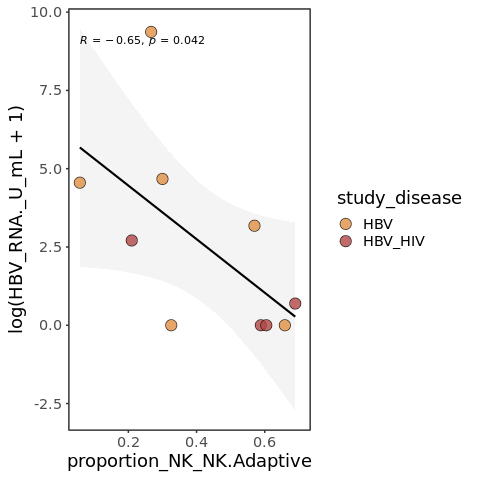

In [72]:
%%R
plot(adap_plot)


In [73]:
%%R
pdf(file = "/well/immune-rep/users/vbw431/Projects/Peppa/new_out/final_plots/NK_clin_corr_plot.pdf",width = 9,height =7)
plot(adap_plot)
dev.off()

`geom_smooth()` using formula = 'y ~ x'
[1] 2


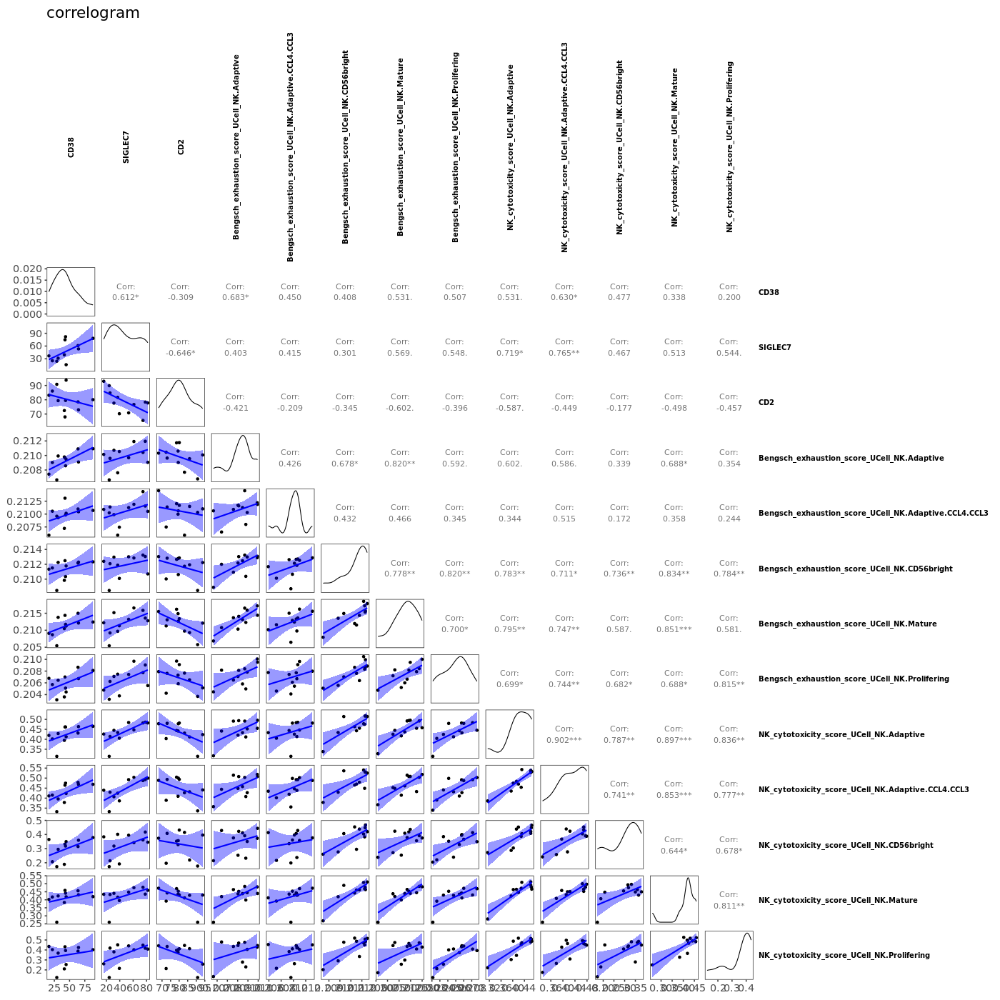

In [74]:
%%R -w 1400 -h 1400
library(GGally)

my_fn <- function(data, mapping, ...){
  p <- ggplot(data = data, mapping = mapping) + 
    geom_point() + 
    geom_smooth(formula = y ~ x,method=lm, fill="blue", color="blue", ...)
  p
}

corr_df <- NK_to_cor2 %>%
select(CD38, SIGLEC7,CD2,
      Bengsch_exhaustion_score_UCell_NK.Adaptive,         
    Bengsch_exhaustion_score_UCell_NK.Adaptive.CCL4.CCL3,
Bengsch_exhaustion_score_UCell_NK.CD56bright,        
Bengsch_exhaustion_score_UCell_NK.Mature,           
Bengsch_exhaustion_score_UCell_NK.Prolifering,       
NK_cytotoxicity_score_UCell_NK.Adaptive,             
NK_cytotoxicity_score_UCell_NK.Adaptive.CCL4.CCL3,   
NK_cytotoxicity_score_UCell_NK.CD56bright,         
NK_cytotoxicity_score_UCell_NK.Mature,            
NK_cytotoxicity_score_UCell_NK.Prolifering,) %>%
unique() 

ggpairs(corr_df, title="correlogram", lower = list(continuous = my_fn))+
       theme(strip.text.x = element_text(size = 10, colour = "black", angle = 90))+
       theme(strip.text.y = element_text(size = 10, colour = "black", angle = 360, hjust=0))

